In [157]:
##importing the required libraries
import pandas as pd
import numpy as np

##importing visualization libraries
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

##importing the pandas profiling package
import pandas_profiling
from pandas_profiling import ProfileReport

##importing the machine learning related libraries
import sklearn
import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn import metrics
from sklearn.preprocessing import PolynomialFeatures
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score

# Importing RFE and RFECV
from sklearn.feature_selection import RFE
from sklearn.feature_selection import RFECV

# Supress Warnings

import warnings
warnings.filterwarnings('ignore')

## Reading and Understanding the dataset

In [158]:
##reading the dataset
housing_data=pd.read_csv("./train.csv")

In [159]:
##Check the data
housing_data.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [160]:
##shape of the data
housing_data.shape

(1460, 81)

In [161]:
##check the columns
housing_data.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [162]:
# describe the data of the numerical columns
housing_data.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,...,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,...,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,...,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,...,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,...,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [163]:
## checking data type of all columns
housing_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

## Data Cleaning

### Treating missing values

In [164]:
#filtering out columns that does not have unique values
housing_data[housing_data.columns[(housing_data.nunique() == 1)]]

""
0
1
2
3
4
...
1455
1456
1457
1458


##### All the columns has unique values

In [165]:
## number of entries in the dataset
housing_data.shape[0]
## checking what columns has no data
(housing_data.isnull().sum()==housing_data.shape[0])

Id               False
MSSubClass       False
MSZoning         False
LotFrontage      False
LotArea          False
                 ...  
MoSold           False
YrSold           False
SaleType         False
SaleCondition    False
SalePrice        False
Length: 81, dtype: bool

In [166]:
## Columns that does not have any data
[housing_data.columns[(housing_data.isnull().sum()==housing_data.shape[0])]]

[Index([], dtype='object')]

In [167]:
## columns that have some missing data
housing_data.columns[housing_data.isnull().sum()>0]

Index(['LotFrontage', 'Alley', 'MasVnrType', 'MasVnrArea', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Electrical', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence',
       'MiscFeature'],
      dtype='object')

In [168]:
## creating a new dataframe for missing columns
missing_values=housing_data[['LotFrontage', 'Alley', 'MasVnrType', 'MasVnrArea', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Electrical', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageQual', 'GarageCond', 'PoolQC', 'Fence',
       'MiscFeature']]

In [169]:
## checking the missing values
(missing_values.isnull().sum()).sort_values(ascending=False)

PoolQC          1453
MiscFeature     1406
Alley           1369
Fence           1179
FireplaceQu      690
LotFrontage      259
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
BsmtExposure      38
BsmtFinType2      38
BsmtFinType1      37
BsmtCond          37
BsmtQual          37
MasVnrArea         8
MasVnrType         8
Electrical         1
dtype: int64

In [170]:
## percentage of missing values
((missing_values.isnull().sum()/missing_values.shape[0])*100).sort_values(ascending=False)

PoolQC          99.520548
MiscFeature     96.301370
Alley           93.767123
Fence           80.753425
FireplaceQu     47.260274
LotFrontage     17.739726
GarageType       5.547945
GarageYrBlt      5.547945
GarageFinish     5.547945
GarageQual       5.547945
GarageCond       5.547945
BsmtExposure     2.602740
BsmtFinType2     2.602740
BsmtFinType1     2.534247
BsmtCond         2.534247
BsmtQual         2.534247
MasVnrArea       0.547945
MasVnrType       0.547945
Electrical       0.068493
dtype: float64

### columns that have major missing values are
> MiscFeature,
> Fence,
> PoolQC,
> Alley,
> FireplaceQu

In [171]:
## analysing major missing values
missing_values[['MiscFeature', 'Fence', 'PoolQC', 'Alley', 'FireplaceQu']]

,MiscFeature,Fence,PoolQC,Alley,FireplaceQu
0,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,TA
2,NaN,NaN,NaN,NaN,TA
3,NaN,NaN,NaN,NaN,Gd
4,NaN,NaN,NaN,NaN,TA
...,...,...,...,...,...
1455,NaN,NaN,NaN,NaN,TA
1456,NaN,MnPrv,NaN,NaN,TA
1457,Shed,GdPrv,NaN,NaN,Gd
1458,NaN,NaN,NaN,NaN,NaN


## looking at the data dictionary it is clear that 
###### PoolQC NA is equal to no pool
###### MiscFeature NA is equal to none
###### Fence NA is equal to no fence
###### FireplaceQU NA is equal to no fireplace
###### Alley NA is equal to no_alley_access
##### Hence, let's impute nan values of the above columns based on data dictionary

In [172]:
housing_data['PoolQC'] = housing_data['PoolQC'].fillna('No_Pool')
housing_data['MiscFeature'] = housing_data['MiscFeature'].fillna('None')
housing_data['Alley'] = housing_data['Alley'].fillna('No_Alley')
housing_data['Fence'] = housing_data['Fence'].fillna('No_Fence')
housing_data['FireplaceQu'] = housing_data['FireplaceQu'].fillna('No_Fireplace')

#### Again checking for columns that have some missing data left

In [173]:
##Checking for missing values after imputing major null values
housing_data.columns[housing_data.isnull().sum()>0]

Index(['LotFrontage', 'MasVnrType', 'MasVnrArea', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Electrical',
       'GarageType', 'GarageYrBlt', 'GarageFinish', 'GarageQual',
       'GarageCond'],
      dtype='object')

In [174]:
## creating a new dataframe for missing columns
missing_values=housing_data[['LotFrontage', 'MasVnrType', 'MasVnrArea', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'Electrical',
       'GarageType', 'GarageYrBlt', 'GarageFinish', 'GarageQual',
       'GarageCond']]

In [175]:
## percentage of missing values
((missing_values.isnull().sum()/missing_values.shape[0])*100).sort_values(ascending=False)

LotFrontage     17.739726
GarageType       5.547945
GarageYrBlt      5.547945
GarageFinish     5.547945
GarageQual       5.547945
GarageCond       5.547945
BsmtExposure     2.602740
BsmtFinType2     2.602740
BsmtQual         2.534247
BsmtCond         2.534247
BsmtFinType1     2.534247
MasVnrType       0.547945
MasVnrArea       0.547945
Electrical       0.068493
dtype: float64

In [176]:
## looking at the "LotFrontage" columns
housing_data[['LotFrontage']].describe()

,LotFrontage
count,1201.000000
mean,70.049958
std,24.284752
min,21.000000
25%,59.000000
50%,69.000000
75%,80.000000
max,313.000000


##### Looking at the data dictionary 'LotFrontage' is the linear feet of street connected to property hence it would be ideal to group it by locality

In [177]:
## Grouping the data and looking at the values
housing_data.groupby("Neighborhood")["LotFrontage"].describe()

,count,mean,std,min,25%,50%,75%,max
Neighborhood,,,,,,,,
Blmngtn,14.0,47.142857,4.990100,43.0,43.00,43.0,53.00,53.0
Blueste,2.0,24.000000,0.000000,24.0,24.00,24.0,24.00,24.0
BrDale,16.0,21.562500,1.209339,21.0,21.00,21.0,21.00,24.0
BrkSide,51.0,57.509804,15.528519,50.0,50.00,52.0,60.00,144.0
ClearCr,13.0,83.461538,18.875096,62.0,75.00,80.0,83.00,138.0
CollgCr,126.0,71.682540,16.359291,36.0,64.00,70.0,78.00,122.0
Crawfor,41.0,71.804878,19.436074,40.0,55.00,74.0,82.00,130.0
Edwards,92.0,68.217391,32.431780,24.0,58.75,65.5,74.25,313.0
Gilbert,49.0,79.877551,32.748176,42.0,60.00,65.0,93.00,182.0


In [178]:
## Imputing the missing values in 'LotFrontage' by Median
housing_data["LotFrontage"] = housing_data.groupby("Neighborhood")["LotFrontage"].transform(lambda a: a.fillna(a.median()))

In [179]:
##Checking for missing values after imputing LotFrontage
housing_data.columns[housing_data.isnull().sum()>0]

Index(['MasVnrType', 'MasVnrArea', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinType2', 'Electrical', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageQual', 'GarageCond'],
      dtype='object')

In [180]:
missing_values=housing_data[['MasVnrType', 'MasVnrArea', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinType2', 'Electrical', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageQual', 'GarageCond']]

In [181]:
## percentage of missing values
((missing_values.isnull().sum()/missing_values.shape[0])*100).sort_values(ascending=False)

GarageType      5.547945
GarageYrBlt     5.547945
GarageFinish    5.547945
GarageQual      5.547945
GarageCond      5.547945
BsmtExposure    2.602740
BsmtFinType2    2.602740
BsmtQual        2.534247
BsmtCond        2.534247
BsmtFinType1    2.534247
MasVnrType      0.547945
MasVnrArea      0.547945
Electrical      0.068493
dtype: float64

#### According to data dictionary Null values in GarageType, GarageFinish, GarageQual, GarageCond columns mean No Garage, hence imputing it with that

In [182]:
##Imputing No_Garage For Null values in GarageType, GarageFinish, GarageQual, GarageCond

housing_data['GarageType'].fillna('No_Garage', inplace=True) 
housing_data['GarageFinish'].fillna('No_Garage', inplace=True) 
housing_data['GarageQual'].fillna('No_Garage', inplace=True) 
housing_data['GarageCond'].fillna('No_Garage', inplace=True) 

In [183]:
##Checking for missing values after imputing GarageType, GarageFinish, GarageQual, GarageCond
housing_data.columns[housing_data.isnull().sum()>0]

Index(['MasVnrType', 'MasVnrArea', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinType2', 'Electrical', 'GarageYrBlt'],
      dtype='object')

In [184]:
missing_values=housing_data[['MasVnrType', 'MasVnrArea', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinType2', 'Electrical', 'GarageYrBlt']]

In [185]:
## percentage of missing values
((missing_values.isnull().sum()/missing_values.shape[0])*100).sort_values(ascending=False)

GarageYrBlt     5.547945
BsmtExposure    2.602740
BsmtFinType2    2.602740
BsmtQual        2.534247
BsmtCond        2.534247
BsmtFinType1    2.534247
MasVnrType      0.547945
MasVnrArea      0.547945
Electrical      0.068493
dtype: float64

#### Variables with prefix as **Bsmt** talks about basement and null values according to data dictionary signifies presence of no basement

In [186]:
##Imputing No_Bsmt For Null values in BsmtExposure, BsmtFinType2, BsmtQual, BsmtCond, BsmtFinType1

housing_data['BsmtExposure'].fillna('No_Bsmt', inplace=True) 
housing_data['BsmtFinType2'].fillna('No_Bsmt', inplace=True) 
housing_data['BsmtQual'].fillna('No_Bsmt', inplace=True) 
housing_data['BsmtCond'].fillna('No_Bsmt', inplace=True)
housing_data['BsmtFinType1'].fillna('No_Bsmt', inplace=True)

In [187]:
##Checking for missing values after imputing BsmtExposure, BsmtFinType2, BsmtQual, BsmtCond, BsmtFinType1
housing_data.columns[housing_data.isnull().sum()>0]

Index(['MasVnrType', 'MasVnrArea', 'Electrical', 'GarageYrBlt'], dtype='object')

In [188]:
## percentage of missing values
((housing_data.isnull().sum()/housing_data.shape[0])*100).sort_values(ascending=False).head(4)

GarageYrBlt    5.547945
MasVnrType     0.547945
MasVnrArea     0.547945
Electrical     0.068493
dtype: float64

In [189]:
## According to data dictionary 'MasVnrType' NA is for None
housing_data['MasVnrType'].fillna('None', inplace=True) 

In [190]:
## Checking MasVnrArea variable
housing_data[[ 'MasVnrArea']].describe()

,MasVnrArea
count,1452.000000
mean,103.685262
std,181.066207
min,0.000000
25%,0.000000
50%,0.000000
75%,166.000000
max,1600.000000


In [191]:
## Imputing the 'MasVnrArea' by it's median (0) since this it's numerical column
housing_data['MasVnrArea'].fillna(0, inplace=True) 

In [192]:
## percentage of missing values
((housing_data.isnull().sum()/housing_data.shape[0])*100).sort_values(ascending=False).head(2)

GarageYrBlt    5.547945
Electrical     0.068493
dtype: float64

#### In data dictionary  'GarageYrBlt'  stands for when the garage was built. null values means no garage, since this is also a numerical column imputing with (0)

In [193]:
## Imputing the 'GarageYrBlt' by zero
housing_data["GarageYrBlt"].fillna(0, inplace=True)

In [194]:
## Checking the last column with missing values
housing_data[['Electrical']].describe()

,Electrical
count,1459
unique,5
top,SBrkr
freq,1334


In [195]:
## Finding the mode for 'Electrical' variable
housing_data['Electrical'].mode()

0    SBrkr
dtype: object

In [196]:
## Imputing the electrical column missing value with it's mode
housing_data['Electrical'].fillna('SBrkr', inplace=True)

In [197]:
## percentage of missing values
((housing_data.isnull().sum()/housing_data.shape[0])*100).sort_values(ascending=False).head()

Id             0.0
CentralAir     0.0
GarageYrBlt    0.0
GarageType     0.0
FireplaceQu    0.0
dtype: float64

In [198]:
##check for duplicate rows in dataset 
housing_data[housing_data.duplicated()]

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice


##### Hence there are no duplicated rows in the dataset

## Data Preparation

### Checking the datatype and correcting it if required

In [199]:
## Checking data types
housing_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1460 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          1460 non-null   object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [200]:
# Segregating Numerical and categorical columns for analysis
numeric_columns = housing_data.select_dtypes(include=['int64', 'float64'])
categorical_columns = housing_data.select_dtypes(include=['object'])

In [201]:
numeric_columns

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,1,60,65.0,8450,7,5,2003,2003,196.0,706,...,0,61,0,0,0,0,0,2,2008,208500
1,2,20,80.0,9600,6,8,1976,1976,0.0,978,...,298,0,0,0,0,0,0,5,2007,181500
2,3,60,68.0,11250,7,5,2001,2002,162.0,486,...,0,42,0,0,0,0,0,9,2008,223500
3,4,70,60.0,9550,7,5,1915,1970,0.0,216,...,0,35,272,0,0,0,0,2,2006,140000
4,5,60,84.0,14260,8,5,2000,2000,350.0,655,...,192,84,0,0,0,0,0,12,2008,250000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1455,1456,60,62.0,7917,6,5,1999,2000,0.0,0,...,0,40,0,0,0,0,0,8,2007,175000
1456,1457,20,85.0,13175,6,6,1978,1988,119.0,790,...,349,0,0,0,0,0,0,2,2010,210000
1457,1458,70,66.0,9042,7,9,1941,2006,0.0,275,...,0,60,0,0,0,0,2500,5,2010,266500
1458,1459,20,68.0,9717,5,6,1950,1996,0.0,49,...,366,0,112,0,0,0,0,4,2010,142125


In [202]:
## Since Id is just a sequence number using this column as an index in the original dataframe
housing_data.set_index('Id', inplace=True)

In [203]:
## looking at the dataset again
housing_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1460 entries, 1 to 1460
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSSubClass     1460 non-null   int64  
 1   MSZoning       1460 non-null   object 
 2   LotFrontage    1460 non-null   float64
 3   LotArea        1460 non-null   int64  
 4   Street         1460 non-null   object 
 5   Alley          1460 non-null   object 
 6   LotShape       1460 non-null   object 
 7   LandContour    1460 non-null   object 
 8   Utilities      1460 non-null   object 
 9   LotConfig      1460 non-null   object 
 10  LandSlope      1460 non-null   object 
 11  Neighborhood   1460 non-null   object 
 12  Condition1     1460 non-null   object 
 13  Condition2     1460 non-null   object 
 14  BldgType       1460 non-null   object 
 15  HouseStyle     1460 non-null   object 
 16  OverallQual    1460 non-null   int64  
 17  OverallCond    1460 non-null   int64  
 18  YearBuil

In [204]:
#changing months to categorical variable
import calendar

housing_data['Month_Sold'] = housing_data['MoSold'].apply(lambda x: calendar.month_name[x])
housing_data=housing_data.drop(['MoSold'], axis=1)

#### Adding derived columns

In [205]:
## if YearBuilt == YearRemodAdd then no renovation was done, creating a new column renovated
def renovated(row):
    if(row['YearBuilt'] == row['YearRemodAdd']):
        return "Not_Renovated"
    elif(row['YearBuilt'] < row['YearRemodAdd']):
        return "Renovated"
    else:
        return "None"
housing_data['Renovated'] = housing_data.apply(renovated, axis=1)  

In [206]:
# PropertyAge = yearsold - yearbuilt
housing_data['Property_Age'] = housing_data['YrSold'] - housing_data['YearBuilt']

In [207]:
#Creating derived column for total porch area 
housing_data['Total_porch_area'] = (housing_data['OpenPorchSF'] + housing_data['3SsnPorch'] + housing_data['EnclosedPorch'] + housing_data['ScreenPorch'] + housing_data['WoodDeckSF'])

In [208]:
#Overall area for all floors and basement
housing_data['Total_Area'] = (housing_data['BsmtFinSF1'] + housing_data['BsmtFinSF2'] + housing_data['1stFlrSF'] + housing_data['2ndFlrSF'])

In [209]:
##Renovated Age
housing_data['Renovated_Age'] = housing_data['YrSold'] - housing_data['YearRemodAdd']


In [210]:
## Garage Age
housing_data['Garage_Age'] = housing_data['YrSold'] - housing_data['GarageYrBlt']

In [211]:
housing_data.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,...,SaleType,SaleCondition,SalePrice,Month_Sold,Renovated,Property_Age,Total_porch_area,Total_Area,Renovated_Age,Garage_Age
Id,,,,,,,,,,,,,,,,,,,,,
1,60,RL,65.0,8450,Pave,No_Alley,Reg,Lvl,AllPub,Inside,...,WD,Normal,208500,February,Not_Renovated,5,61,2416,5,5.0
2,20,RL,80.0,9600,Pave,No_Alley,Reg,Lvl,AllPub,FR2,...,WD,Normal,181500,May,Not_Renovated,31,298,2240,31,31.0
3,60,RL,68.0,11250,Pave,No_Alley,IR1,Lvl,AllPub,Inside,...,WD,Normal,223500,September,Renovated,7,42,2272,6,7.0
4,70,RL,60.0,9550,Pave,No_Alley,IR1,Lvl,AllPub,Corner,...,WD,Abnorml,140000,February,Renovated,91,307,1933,36,8.0
5,60,RL,84.0,14260,Pave,No_Alley,IR1,Lvl,AllPub,FR2,...,WD,Normal,250000,December,Not_Renovated,8,276,2853,8,8.0


In [212]:
## Since we have extracted the data out of the 'YearBuilt', 'YearRemodAdd', 'YrSold', 'GarageYrBlt' variables dropping these
housing_data.drop(['YearBuilt', 'YearRemodAdd', 'YrSold', 'GarageYrBlt'], axis = 1, inplace = True)

In order to avoid class imbalance we remove categorical values that have more than 90% data associated to one value

In [213]:
## Creating a function to find class imbalance in numerical columns
def classimbalance_numeric():
    skewedcolumns = []
    numeric_columns = housing_data.select_dtypes(include=['int64', 'float'])
    for i in (numeric_columns):
        if(housing_data[i].value_counts().max() >= (housing_data.shape[0]*0.90)):
            skewedcolumns.append(i)
    return skewedcolumns

In [214]:
## initializing the function
numeric_columns_with_class_imbalance=classimbalance_numeric()

In [215]:
## columns with class imbalance
numeric_columns_with_class_imbalance

['LowQualFinSF',
 'BsmtHalfBath',
 'KitchenAbvGr',
 '3SsnPorch',
 'ScreenPorch',
 'PoolArea',
 'MiscVal']

In [216]:
## checking the columns before dropping them
housing_data[['LowQualFinSF',
 'BsmtHalfBath',
 'KitchenAbvGr',
 '3SsnPorch',
 'ScreenPorch',
 'PoolArea',
 'MiscVal']]

,LowQualFinSF,BsmtHalfBath,KitchenAbvGr,3SsnPorch,ScreenPorch,PoolArea,MiscVal
Id,,,,,,,
1,0,0,1,0,0,0,0
2,0,1,1,0,0,0,0
3,0,0,1,0,0,0,0
4,0,0,1,0,0,0,0
5,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...
1456,0,0,1,0,0,0,0
1457,0,0,1,0,0,0,0
1458,0,0,1,0,0,0,2500


In [217]:
## dropping these skeweed columns
housing_data.drop(['LowQualFinSF',
 'BsmtHalfBath',
 'KitchenAbvGr',
 '3SsnPorch',
 'ScreenPorch',
 'PoolArea',
 'MiscVal'], axis = 1, inplace = True)

#### Let's look at categorical columns for class imbalance

In [218]:
categorical_columns = housing_data.select_dtypes(include=['object'])

In [219]:
categorical_columns

,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,...,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition,Month_Sold,Renovated
Id,,,,,,,,,,,,,,,,,,,,,
1,RL,Pave,No_Alley,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,...,TA,TA,Y,No_Pool,No_Fence,None,WD,Normal,February,Not_Renovated
2,RL,Pave,No_Alley,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,...,TA,TA,Y,No_Pool,No_Fence,None,WD,Normal,May,Not_Renovated
3,RL,Pave,No_Alley,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,...,TA,TA,Y,No_Pool,No_Fence,None,WD,Normal,September,Renovated
4,RL,Pave,No_Alley,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,...,TA,TA,Y,No_Pool,No_Fence,None,WD,Abnorml,February,Renovated
5,RL,Pave,No_Alley,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,...,TA,TA,Y,No_Pool,No_Fence,None,WD,Normal,December,Not_Renovated
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1456,RL,Pave,No_Alley,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,...,TA,TA,Y,No_Pool,No_Fence,None,WD,Normal,August,Renovated
1457,RL,Pave,No_Alley,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,...,TA,TA,Y,No_Pool,MnPrv,None,WD,Normal,February,Renovated
1458,RL,Pave,No_Alley,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,...,TA,TA,Y,No_Pool,GdPrv,Shed,WD,Normal,May,Renovated


In [220]:
## Creating a function to find class imbalance in categorical columns
def classimbalance_categorical(x):
    skewedcolumns = []
    for i in x.columns:
        count = x[i].value_counts()
        max_count = count.iloc[0]
        if max_count / len(x) * 100 > 98:
            skewedcolumns.append(i)
    return skewedcolumns

In [221]:
## initializing the function
categorical_columns_with_class_imbalance=classimbalance_categorical(categorical_columns)

In [222]:
categorical_columns_with_class_imbalance

['Street', 'Utilities', 'Condition2', 'RoofMatl', 'PoolQC']

In [223]:
## dropping these skewed columns
housing_data.drop(['Street', 'Utilities', 'Condition2', 'RoofMatl', 'PoolQC'], axis = 1, inplace = True)

## Univariate, Bivariate Analysis

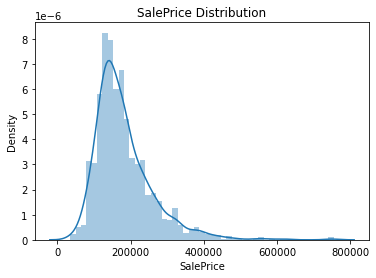

In [224]:
# Checking distribution of Target Variable 'SalePrice'
sns.distplot(housing_data['SalePrice'])
plt.title('SalePrice Distribution')
plt.show()

##### Since SalePrice variable is highly skewed let's transform it (log transformation) and check for it's distribution

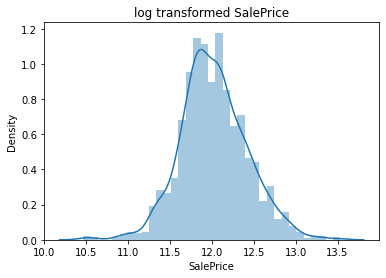

In [225]:
sns.distplot(np.log(housing_data['SalePrice']))
plt.title('log transformed SalePrice')
plt.show()

##### After log transformartion it looks to be normally distributed now

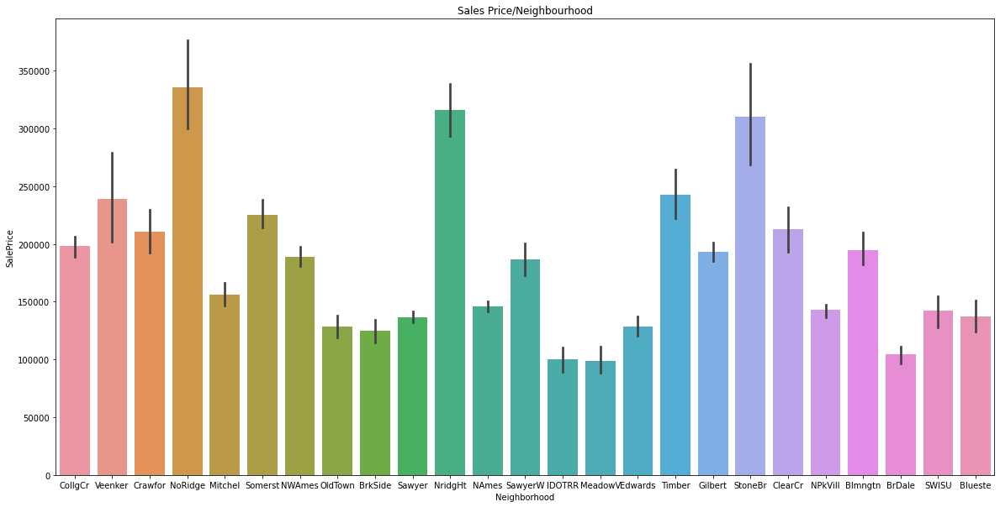

In [226]:
## Neighbourhood vs SalePrice
plt.figure(figsize=(20, 10))
sns.barplot(x="Neighborhood", y="SalePrice", data= housing_data)
plt.title("Sales Price/Neighbourhood")
plt.show()

### Some Neighbourhood are costlier as compared to others

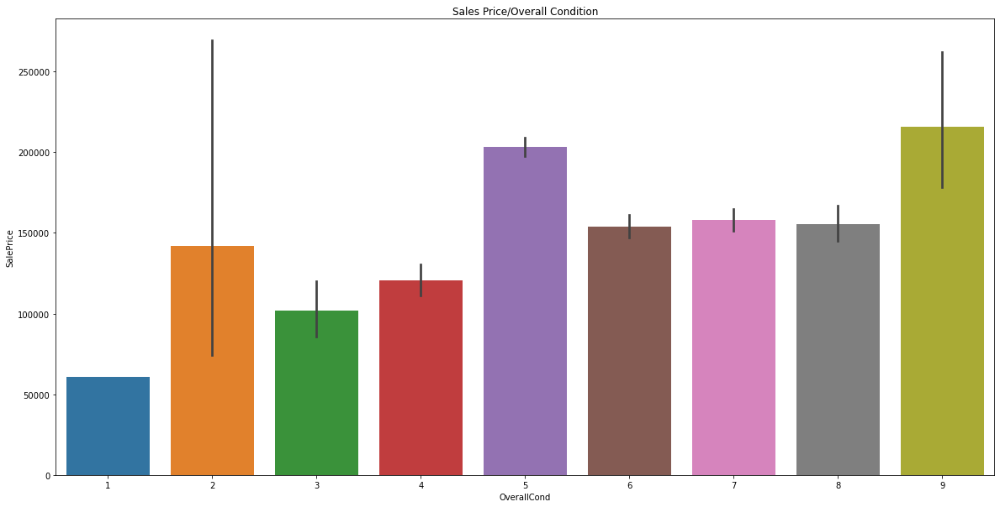

In [227]:
## Sale price versus overall condition
plt.figure(figsize=(20, 10))
sns.barplot(x="OverallCond", y="SalePrice", data= housing_data)
plt.title("Sales Price/Overall Condition")
plt.show()

### As overall condition is good salesprice increases

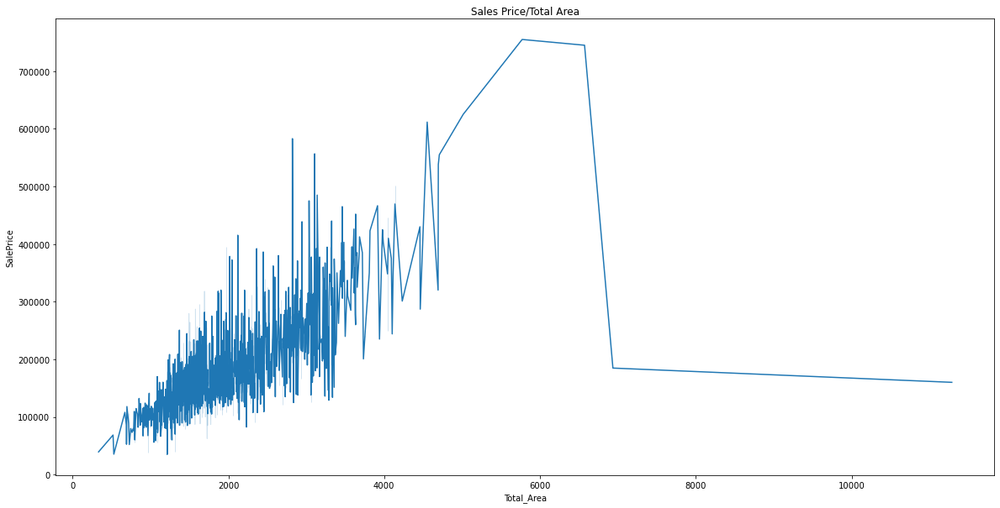

In [228]:
## Total Area versus Sale Price
plt.figure(figsize=(20, 10))
sns.lineplot(x="Total_Area", y="SalePrice", data= housing_data)
plt.title("Sales Price/Total Area")
plt.show()

### Linear pattern in Total Area versus Saleprice however there seems to be some outliers at the high end

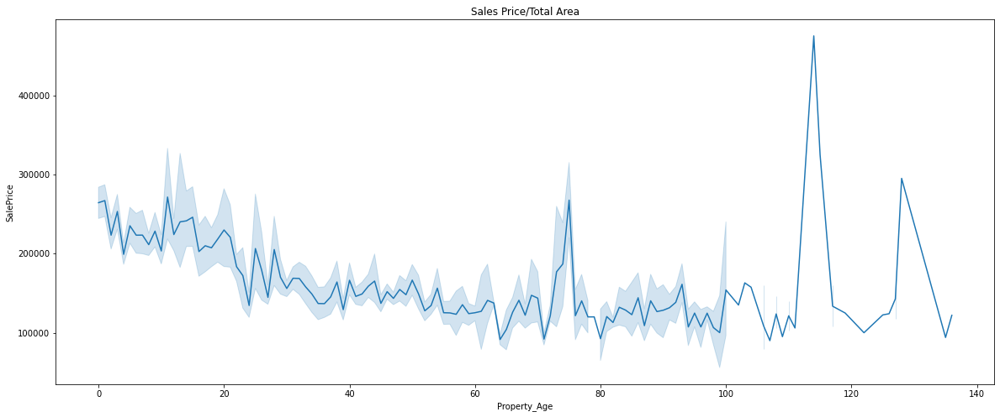

In [229]:
## Property Age versus sale price
plt.figure(figsize=(20, 8))
sns.lineplot(x="Property_Age", y="SalePrice", data= housing_data)
plt.title("Sales Price/Total Area")
plt.show()

### As property Age increases Sale Price decrease, we also see home outliers at the high end

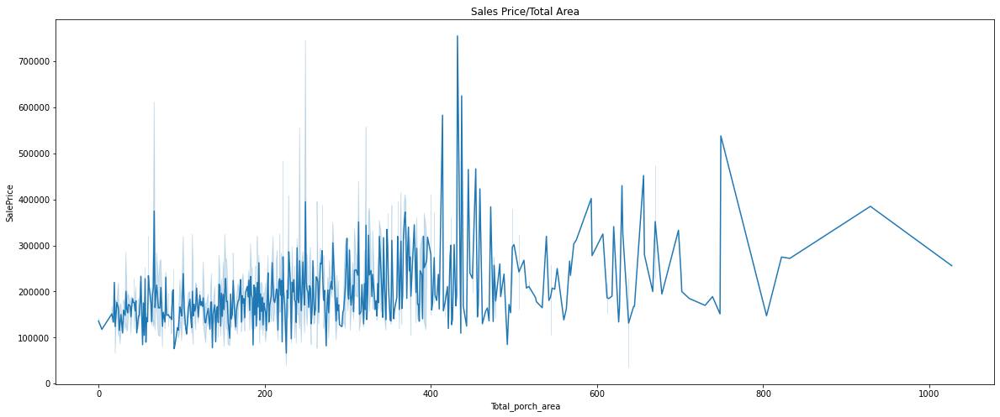

In [230]:
## Total porch area vs Sale Price
plt.figure(figsize=(20, 8))
sns.lineplot(x="Total_porch_area", y="SalePrice", data= housing_data)
plt.title("Sales Price/Total Area")
plt.show()

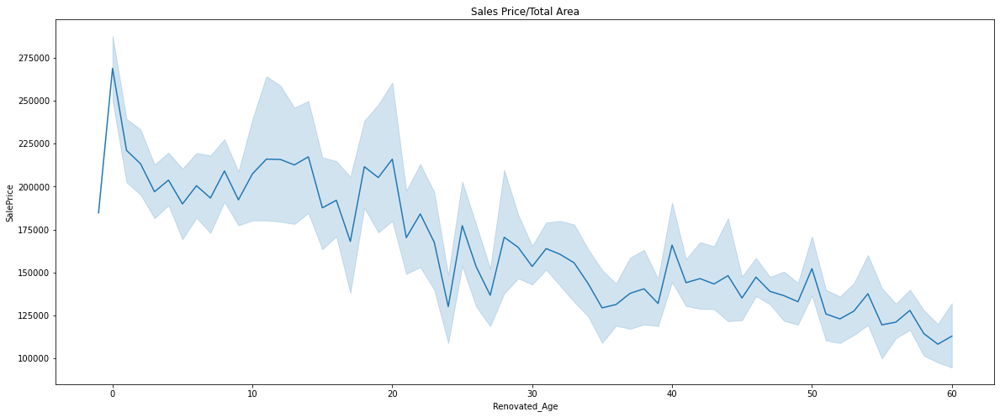

In [231]:
## Renovated Age versus Sale Price
plt.figure(figsize=(20, 8))
sns.lineplot(x="Renovated_Age", y="SalePrice", data= housing_data)
plt.title("Sales Price/Total Area")
plt.show()

### As Renovated Age increases Sale Price decrease, we also see home outliers at the high end

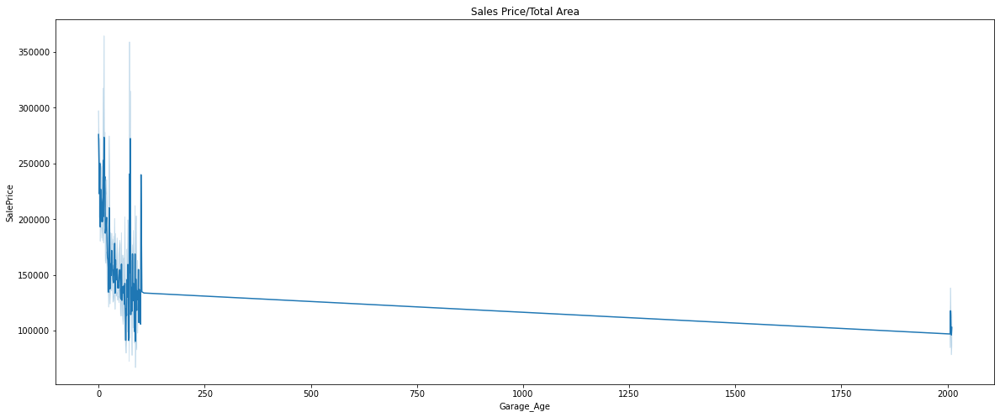

In [232]:
## Garage Age versus SalePrice
plt.figure(figsize=(20, 8))
sns.lineplot(x="Garage_Age", y="SalePrice", data= housing_data)
plt.title("Sales Price/Total Area")
plt.show()

In [233]:
## Finding numeric columns
numeric_columns = housing_data.select_dtypes(include=['int64', 'float64'])

In [234]:
numeric_columns.columns

Index(['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond',
       'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF',
       '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars',
       'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', 'SalePrice',
       'Property_Age', 'Total_porch_area', 'Total_Area', 'Renovated_Age',
       'Garage_Age'],
      dtype='object')

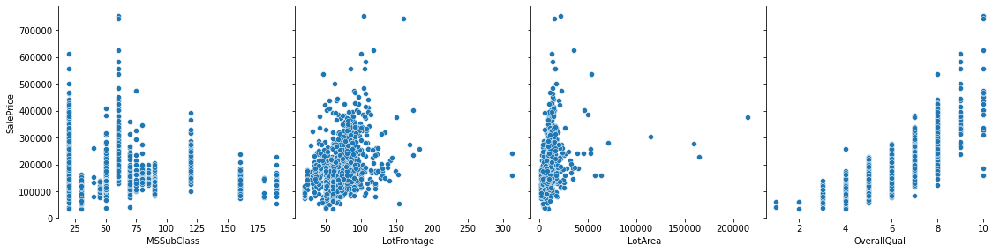

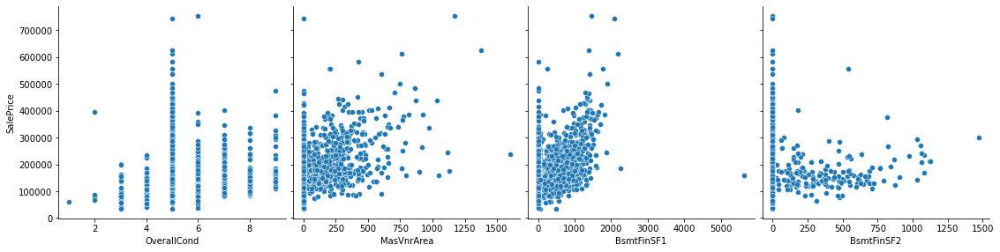

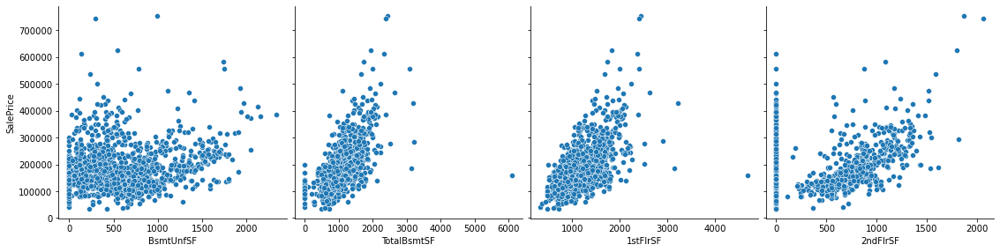

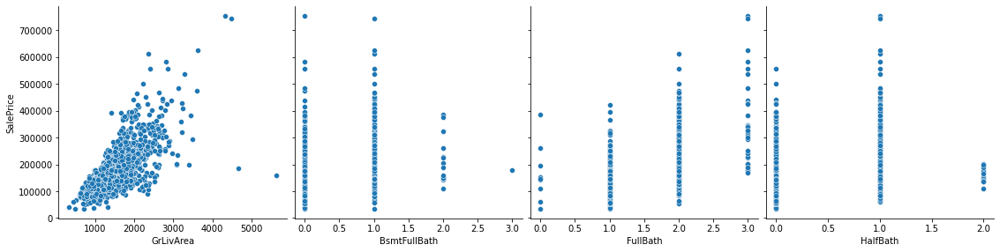

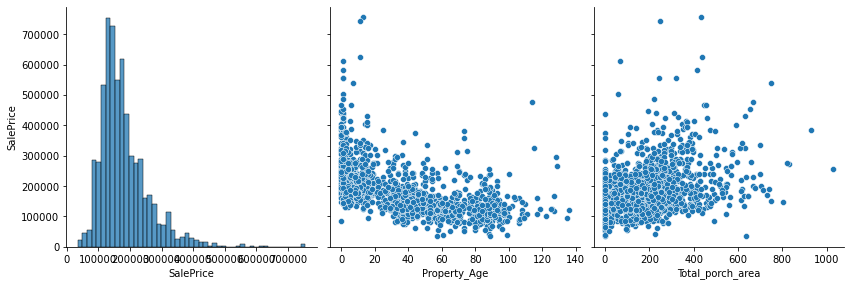

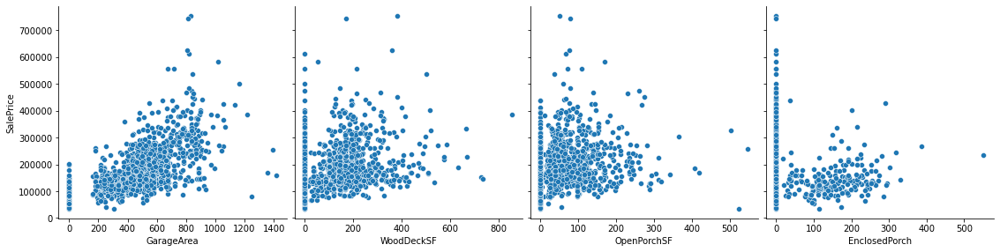

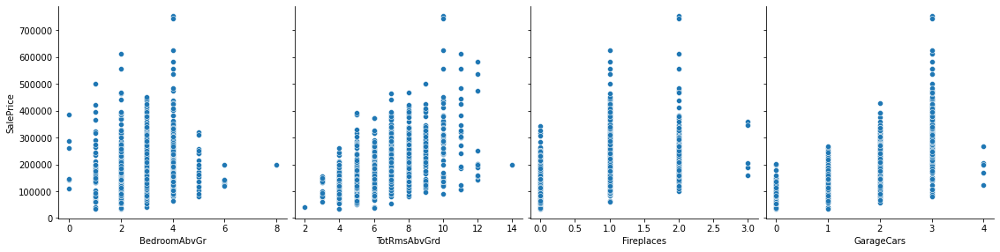

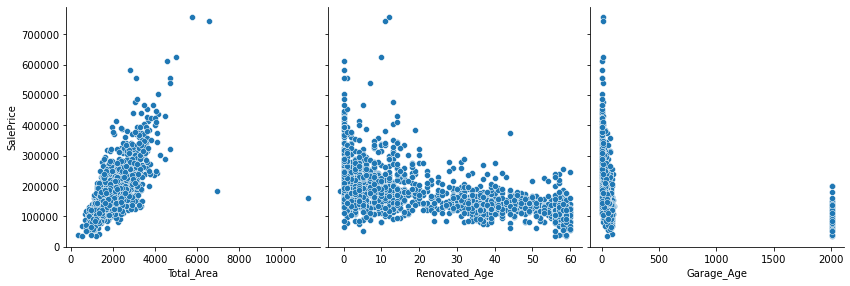

In [235]:
## Creating pair plots between these numerical columns
sns.pairplot(housing_data, x_vars=['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual'], y_vars='SalePrice',height=4, aspect=1,kind='scatter')
sns.pairplot(housing_data, x_vars=['OverallCond',
       'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2'], y_vars='SalePrice',height=4, aspect=1,kind='scatter')
sns.pairplot(housing_data, x_vars=['BsmtUnfSF', 'TotalBsmtSF',
       '1stFlrSF', '2ndFlrSF'], y_vars='SalePrice',height=4, aspect=1,kind='scatter')
sns.pairplot(housing_data, x_vars=['GrLivArea', 'BsmtFullBath', 'FullBath',
       'HalfBath'], y_vars='SalePrice',height=4, aspect=1,kind='scatter')
sns.pairplot(housing_data, x_vars=['SalePrice',
       'Property_Age', 'Total_porch_area'], y_vars='SalePrice',height=4, aspect=1,kind='scatter')
sns.pairplot(housing_data, x_vars=['GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch'], y_vars='SalePrice',height=4, aspect=1,kind='scatter')
sns.pairplot(housing_data, x_vars=['BedroomAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars'], y_vars='SalePrice',height=4, aspect=1,kind='scatter')
sns.pairplot(housing_data, x_vars=['Total_Area', 'Renovated_Age', 'Garage_Age'], y_vars='SalePrice',height=4, aspect=1,kind='scatter')
plt.show()

In [236]:
## As we can see that 'EnclosedPorch' and 'BsmtFinSF2' does not have any pattern and it is just one value we can drop these
housing_data.drop(['Garage_Age'], axis = 1, inplace = True)

### We can see that variables like 'TotalArea', 'TotalBsmtSF', '1stFlrSF','2ndFlrSF', 'GrLivArea' and 'OverallQual' shows a linear relationship with the target variable

In [237]:
## checking categorical columns
categorical_columns = housing_data.select_dtypes(include=['object'])

In [238]:
categorical_columns.columns

Index(['MSZoning', 'Alley', 'LotShape', 'LandContour', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'BldgType', 'HouseStyle',
       'RoofStyle', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual',
       'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir',
       'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType',
       'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'Fence',
       'MiscFeature', 'SaleType', 'SaleCondition', 'Month_Sold', 'Renovated'],
      dtype='object')

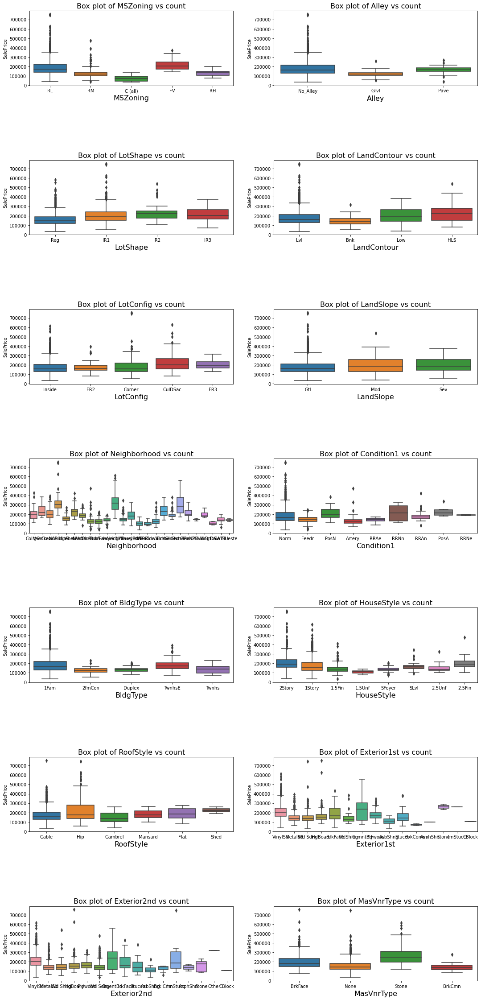

In [239]:
# Box plot of categorical columns

cat_columns_1=['MSZoning', 'Alley', 'LotShape', 'LandContour', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'BldgType', 'HouseStyle',
       'RoofStyle', 'Exterior1st', 'Exterior2nd', 'MasVnrType']
plt.figure(figsize=[18, 40])

for i, j in enumerate(cat_columns_1, 1):
    plt.subplot(7,2,i)
    plt.subplots_adjust(hspace = 1.0)
    title= f'Box plot of {j} vs count'
    label= f'{j}'
    fig= sns.boxplot(data= housing_data, x= j, y= 'SalePrice')
    fig.set_title(title, fontdict= { 'fontsize': 16})
    fig.set_xlabel(label, fontdict= {'fontsize': 16})
plt.show()

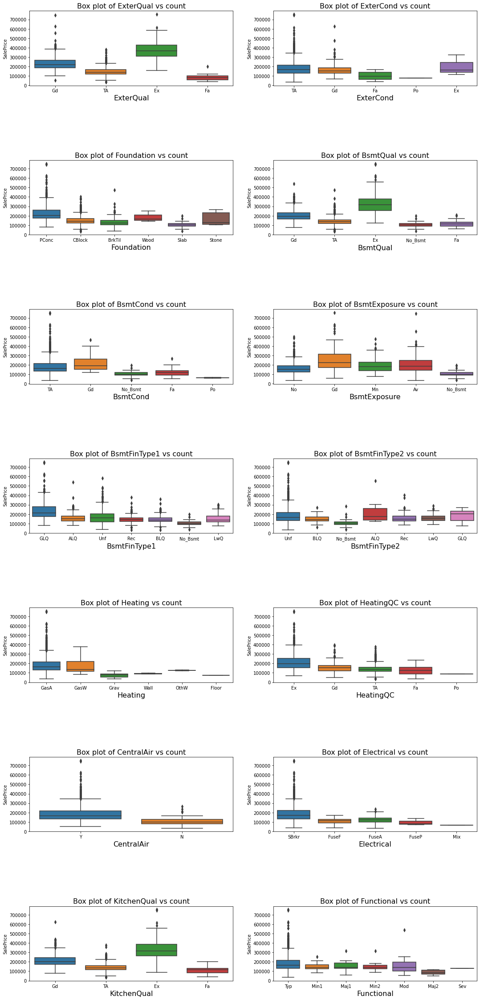

In [240]:
# Box plot of categorical columns

cat_columns_2=['ExterQual',
       'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir',
       'Electrical', 'KitchenQual', 'Functional']
plt.figure(figsize=[18, 40])

for i, j in enumerate(cat_columns_2, 1):
    plt.subplot(7,2,i)
    plt.subplots_adjust(hspace = 1.0)
    title= f'Box plot of {j} vs count'
    label= f'{j}'
    fig= sns.boxplot(data= housing_data, x= j, y= 'SalePrice')
    fig.set_title(title, fontdict= { 'fontsize': 16})
    fig.set_xlabel(label, fontdict= {'fontsize': 16})
plt.show()

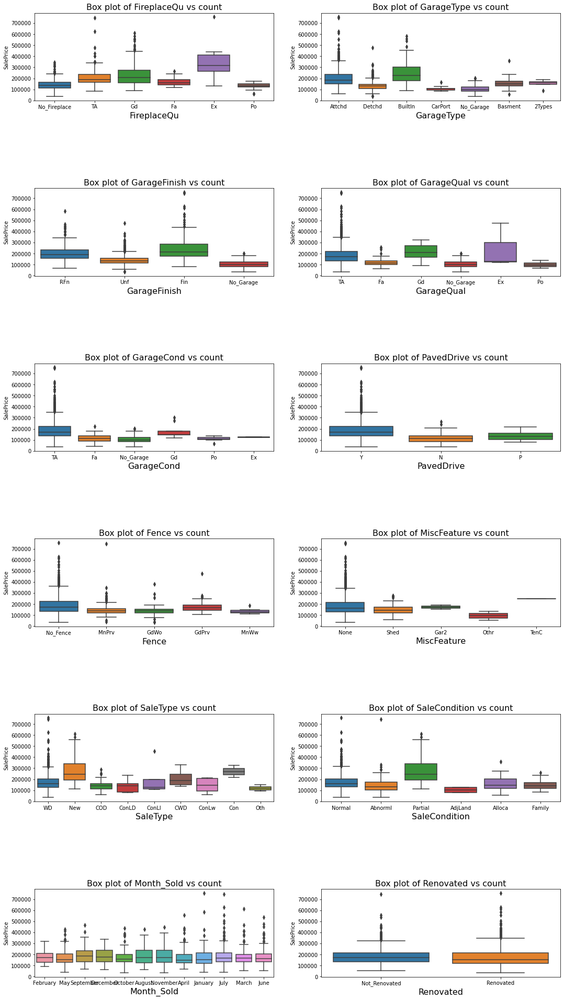

In [241]:
# Box plot of categorical columns

cat_columns_3=['FireplaceQu', 'GarageType',
       'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'Fence',
       'MiscFeature', 'SaleType', 'SaleCondition', 'Month_Sold', 'Renovated']
plt.figure(figsize=[18, 40])

for i, j in enumerate(cat_columns_3, 1):
    plt.subplot(7,2,i)
    plt.subplots_adjust(hspace = 1.0)
    title= f'Box plot of {j} vs count'
    label= f'{j}'
    fig= sns.boxplot(data= housing_data, x= j, y= 'SalePrice')
    fig.set_title(title, fontdict= { 'fontsize': 16})
    fig.set_xlabel(label, fontdict= {'fontsize': 16})
plt.show()

## From the boxplots we can see that there are lot of outliers present in the data

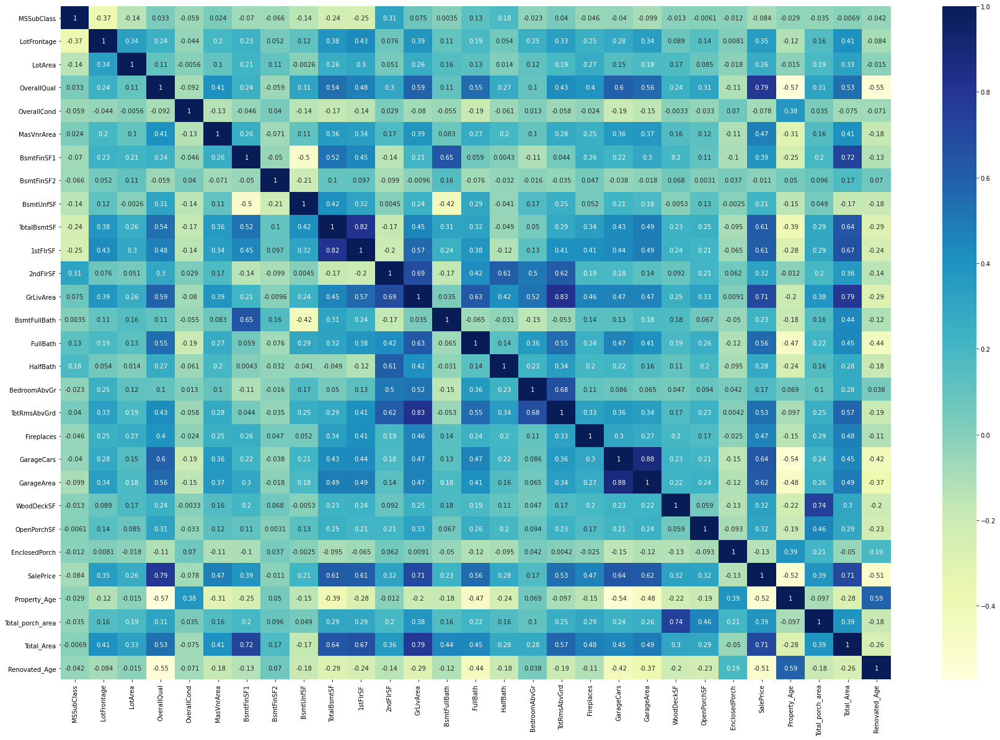

In [242]:
# plotting correlations on a heatmap

# figure size
plt.figure(figsize=(30,20))

# heatmap
sns.heatmap(housing_data.corr(), cmap="YlGnBu", annot=True)
plt.show()

In [243]:
## checking for values for whose corelation is higher than 80
(housing_data.corr()>0.80)

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,...,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,SalePrice,Property_Age,Total_porch_area,Total_Area,Renovated_Age
MSSubClass,True,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
LotFrontage,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
LotArea,False,False,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
OverallQual,False,False,False,True,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
OverallCond,False,False,False,False,True,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
MasVnrArea,False,False,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
BsmtFinSF1,False,False,False,False,False,False,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
BsmtFinSF2,False,False,False,False,False,False,False,True,False,False,...,False,False,False,False,False,False,False,False,False,False
BsmtUnfSF,False,False,False,False,False,False,False,False,True,False,...,False,False,False,False,False,False,False,False,False,False
TotalBsmtSF,False,False,False,False,False,False,False,False,False,True,...,False,False,False,False,False,False,False,False,False,False


#### we can see that 'TotalBsmtSF' and 'GarageArea' is showing high corelation hence dropping these

In [244]:
## As we can see that 'GarageArea' and 'TotalBsmtSF' does not have any pattern and it is just one value we can drop these
housing_data.drop(['TotalBsmtSF', 'GarageArea'], axis = 1, inplace = True)

### Outlier Treatment

In [245]:
# Checking outliers at 25%,50%,75%,90%,95%,98& and 99%

housing_data.describe(percentiles=[.25,.5,.75,.90,.95,.98,.99])

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,1stFlrSF,...,Fireplaces,GarageCars,WoodDeckSF,OpenPorchSF,EnclosedPorch,SalePrice,Property_Age,Total_porch_area,Total_Area,Renovated_Age
count,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,...,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,56.897260,70.199658,10516.828082,6.099315,5.575342,103.117123,443.639726,46.549315,567.240411,1162.626712,...,0.613014,1.767123,94.244521,46.660274,21.954110,180921.195890,36.547945,181.329452,1999.808219,22.950000
std,42.300571,22.431902,9981.264932,1.382997,1.112799,180.731373,456.098091,161.319273,441.866955,386.587738,...,0.644666,0.747315,125.338794,66.256028,61.119149,79442.502883,30.250152,156.656097,773.992942,20.640653
min,20.000000,21.000000,1300.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,334.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,34900.000000,0.000000,0.000000,334.000000,-1.000000
25%,20.000000,60.000000,7553.500000,5.000000,5.000000,0.000000,0.000000,0.000000,223.000000,882.000000,...,0.000000,1.000000,0.000000,0.000000,0.000000,129975.000000,8.000000,45.000000,1493.000000,4.000000
50%,50.000000,70.000000,9478.500000,6.000000,5.000000,0.000000,383.500000,0.000000,477.500000,1087.000000,...,1.000000,2.000000,0.000000,25.000000,0.000000,163000.000000,35.000000,164.000000,1863.500000,14.000000
75%,70.000000,80.000000,11601.500000,7.000000,6.000000,164.250000,712.250000,0.000000,808.000000,1391.250000,...,1.000000,2.000000,168.000000,68.000000,0.000000,214000.000000,54.000000,266.000000,2383.500000,41.000000
90%,120.000000,92.000000,14381.700000,8.000000,7.000000,335.000000,1065.500000,117.200000,1232.000000,1680.000000,...,1.000000,3.000000,262.000000,130.000000,112.000000,278000.000000,84.000000,382.000000,3023.100000,56.000000
95%,160.000000,104.000000,17401.150000,8.000000,8.000000,456.000000,1274.000000,396.200000,1468.000000,1831.250000,...,2.000000,3.000000,335.000000,175.050000,180.150000,326100.000000,91.000000,472.150000,3334.150000,58.000000
98%,188.200000,120.820000,25251.620000,9.000000,8.000000,650.820000,1442.640000,658.120000,1678.200000,2072.280000,...,2.000000,3.000000,430.100000,240.820000,235.640000,394931.060000,100.000000,613.640000,3733.280000,59.000000


#### Looking at the data it is clearly evident that most of the numerical variables has outliers

In [246]:
numeric_columns = housing_data.select_dtypes(include=['int64', 'float64'])

In [247]:
## initializing an empty dictionary
outliers={}

for i in numeric_columns.columns:
    ## defining the IQR range (p75-p25)
    IQR=numeric_columns[i].quantile(.75)-numeric_columns[i].quantile(.25)
    outliers_values=numeric_columns[(numeric_columns[i]>(numeric_columns[i].quantile(.75)+1.5*IQR)) | (numeric_columns[i]<(numeric_columns[i].quantile(.25)-1.5*IQR))].shape[0]
    outliers[i]=round(outliers_values/numeric_columns.shape[0]*100,2)
    
## creating a new data frame
outlier_data=pd.DataFrame({'Attribute':list(outliers.keys()),'Percent':list(outliers.values())})
outlier_data.sort_values(by="Percent", ascending=False)

,Attribute,Percent
21,EnclosedPorch,14.25
7,BsmtFinSF2,11.44
4,OverallCond,8.56
0,MSSubClass,7.05
5,MasVnrArea,6.71
1,LotFrontage,6.37
20,OpenPorchSF,5.27
2,LotArea,4.73
22,SalePrice,4.18
15,BedroomAbvGr,2.40


#### We will not drop the values as it will reduce the data for our final model. Hence we will fix the max and min values for the values that are falling beyond the range

In [248]:
## fixing the outliers to min and max and excluding our target variable
for i,j in outliers.items():
    if i!='SalePrice':
        IQR = housing_data[i].quantile(.75) - housing_data[i].quantile(.25) 
        maximum = housing_data[i].quantile(.75)+1.5*IQR
        minimum = housing_data[i].quantile(.25)-1.5*IQR
        housing_data[i][housing_data[i] > maximum] = maximum
        housing_data[i][housing_data[i] < minimum ] = minimum

#### Automated EDA using Pandas Profiling Package

In [249]:
## Generating a report on the data using pandas profiling
profile = ProfileReport(housing_data, title="EDA for Housing data")

In [250]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Model Building

#### Creating encoding values
#### transforming target variable
#### scaling
#### Model Building

In [251]:
housing_data.columns

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Alley', 'LotShape',
       'LandContour', 'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1',
       'BldgType', 'HouseStyle', 'OverallQual', 'OverallCond', 'RoofStyle',
       'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea', 'ExterQual',
       'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenQual', 'TotRmsAbvGrd', 'Functional',
       'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageCars',
       'GarageQual', 'GarageCond', 'PavedDrive', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', 'Fence', 'MiscFeature', 'SaleType', 'SaleCondition',
       'SalePrice', 'Month_Sold', 'Renovated', 'Property_Age',
       'Total_porch_area'

In [252]:
## Based on data dictionary defining the unordered categorical variables
unordered_variables = ['MSZoning', 'Alley', 'LandContour', 'LotConfig', 'Neighborhood', 'Condition1', 'BldgType', 'RoofStyle', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'Foundation', 'Heating', 'Electrical', 'Functional', 'GarageType','PavedDrive', 'Fence','MiscFeature', 'SaleType','SaleCondition']

#### We will be doing one hot encoding for these

In [253]:
## Creating temp dataframe using one hot encoding on unordered variables
temp_dataframe=pd.get_dummies(housing_data[unordered_variables], drop_first=True)

In [254]:
ordered_variables=['MSSubClass', 'LotFrontage', 'LotArea', 'LotShape', 'LandSlope', 'HouseStyle','1stFlrSF',
       '2ndFlrSF', 'GrLivArea', 'BsmtFullBath','GarageFinish', 'GarageCars', 'GarageQual', 'GarageCond', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenQual', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch',
       'TotRmsAbvGrd', 'Fireplaces', 'FireplaceQu', 'OverallQual', 'OverallCond', 'MasVnrArea', 'ExterQual',
       'ExterCond','BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF','HeatingQC', 'CentralAir','Month_Sold',
       'Renovated', 'Property_Age', 'Total_porch_area', 'Total_Area',
       'Renovated_Age']

In [255]:
## checking the shape of the temp dataframe
temp_dataframe.shape

(1460, 135)

### Since these are very high number, we will drop the columns that has class imbalance
#### We will  reuse our function defined above for finding class imbalance in this dataframe

In [256]:
##finding class imbalance in encoded columns
encoded_columns_with_class_imbalance=classimbalance_categorical(temp_dataframe)

In [257]:
encoded_columns_with_class_imbalance

['MSZoning_RH',
 'LotConfig_FR3',
 'Neighborhood_Blueste',
 'Neighborhood_BrDale',
 'Neighborhood_ClearCr',
 'Neighborhood_MeadowV',
 'Neighborhood_NPkVill',
 'Neighborhood_SWISU',
 'Neighborhood_StoneBr',
 'Neighborhood_Veenker',
 'Condition1_PosA',
 'Condition1_PosN',
 'Condition1_RRAe',
 'Condition1_RRAn',
 'Condition1_RRNe',
 'Condition1_RRNn',
 'RoofStyle_Gambrel',
 'RoofStyle_Mansard',
 'RoofStyle_Shed',
 'Exterior1st_AsphShn',
 'Exterior1st_BrkComm',
 'Exterior1st_CBlock',
 'Exterior1st_ImStucc',
 'Exterior1st_Stone',
 'Exterior1st_Stucco',
 'Exterior1st_WdShing',
 'Exterior2nd_AsphShn',
 'Exterior2nd_Brk Cmn',
 'Exterior2nd_BrkFace',
 'Exterior2nd_CBlock',
 'Exterior2nd_ImStucc',
 'Exterior2nd_Other',
 'Exterior2nd_Stone',
 'Exterior2nd_Stucco',
 'Foundation_Slab',
 'Foundation_Stone',
 'Foundation_Wood',
 'Heating_GasW',
 'Heating_Grav',
 'Heating_OthW',
 'Heating_Wall',
 'Electrical_FuseF',
 'Electrical_FuseP',
 'Electrical_Mix',
 'Functional_Maj2',
 'Functional_Mod',
 'Funct

In [258]:
# Dropping the highly imbalanced encoded variables

temp_dataframe = temp_dataframe.drop(encoded_columns_with_class_imbalance, axis=1)

print(temp_dataframe.shape)

(1460, 74)


In [259]:
# Adding temp dataframe to the original dataframe
housing_data = pd.concat([housing_data,temp_dataframe],axis=1)

# Dropping the columns from the original dataframe for which we did the encoding
housing_data = housing_data.drop(unordered_variables,axis=1)

In [260]:
## Checking variables that has object type
housing_data[ordered_variables].select_dtypes(include=['object']).columns

Index(['LotShape', 'LandSlope', 'HouseStyle', 'GarageFinish', 'GarageQual',
       'GarageCond', 'KitchenQual', 'FireplaceQu', 'ExterQual', 'ExterCond',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'HeatingQC', 'CentralAir', 'Month_Sold', 'Renovated'],
      dtype='object')

### label encoding for ordered variables

In [261]:
## Based on the data dictionary doing label encoding for ordered categorical variables
housing_data['LotShape'] = housing_data['LotShape'].map({'IR1':2,'IR2':1,'IR3':0,'Reg':3})
housing_data['LandSlope'] = housing_data['LandSlope'].map({'Gtl':2,'Mod':1,'Sev':0})
housing_data['GarageQual'] = housing_data['GarageQual'].map({'No_Garage':0,'Po':1,'Fa':2,'TA':3,'Gd':4,'Ex':5})
housing_data['GarageCond'] = housing_data['GarageCond'].map({'No_Garage':0,'Po':1,'Fa':2,'TA':3,'Gd':4,'Ex':5})
housing_data['GarageFinish'] = housing_data['GarageFinish'].map({'No_Garage':0,'Unf':1,'RFn':2,'Fin':3})
housing_data['HouseStyle'] = housing_data['HouseStyle'].map({'1Story':0, '1.5Unf':1, '1.5Fin':2,  '2Story' :3, '2.5Unf':4, '2.5Fin':5, 'SFoyer':6, 'SLvl':7})
housing_data['CentralAir'] = housing_data['CentralAir'].map({'N':0,'Y':1})
housing_data['KitchenQual'] = housing_data['KitchenQual'].map({'Po':0,'Fa':1,'TA':2,'Gd':3,'Ex':4})
housing_data['ExterQual'] = housing_data['ExterQual'].map({'Po':0,'Fa':1,'TA':2,'Gd':3,'Ex':4})
housing_data['ExterCond'] = housing_data['ExterCond'].map({'Po':0,'Fa':1,'TA':2,'Gd':3,'Ex':4})
housing_data['BsmtQual'] = housing_data['BsmtQual'].map({'No_Bsmt':0,'Po':1,'Fa':2,'TA':3,'Gd':4,'Ex':5})
housing_data['BsmtCond'] = housing_data['BsmtCond'].map({'No_Bsmt':0,'Po':1,'Fa':2,'TA':3,'Gd':4,'Ex':5})
housing_data['BsmtExposure'] = housing_data['BsmtExposure'].map({'No_Bsmt':0,'No':1,'Mn':2,'Av':3,'Gd':4})
housing_data['BsmtFinType1'] = housing_data['BsmtFinType1'].map({'No_Bsmt':0,'Unf':1,'LwQ':2,'Rec':3,'BLQ':4,'ALQ':5,'GLQ':6})
housing_data['BsmtFinType2'] = housing_data['BsmtFinType2'].map({'No_Bsmt':0,'Unf':1,'LwQ':2,'Rec':3,'BLQ':4,'ALQ':5,'GLQ':6})
housing_data['HeatingQC'] = housing_data['HeatingQC'].map({'Po':0,'Fa':1,'TA':2,'Gd':3,'Ex':4})

In [262]:
## checking the remaining columns
housing_data[ordered_variables].select_dtypes(include=['object']).columns

Index(['FireplaceQu', 'Month_Sold', 'Renovated'], dtype='object')

In [263]:
## Doing label encoding for the remaining columns
housing_data['FireplaceQu'] = housing_data['FireplaceQu'].map({'No_Fireplace':0,'Po':1,'Fa':2,'TA':3, 'Gd':4 , 'Ex':5})
housing_data['Month_Sold'] = housing_data['Month_Sold'].map({'January':0,'February':1,'March':2, 'April':3,'May':4,'June':5, 'July':6,'August':7,'September':8, 'October':9,'November':10,'December':11})

In [264]:
housing_data['Renovated']=housing_data['Renovated'].map({'Not_Renovated':0,'Renovated':1})

In [265]:
## Checking the dataframe after encoding is done
housing_data.head()

,MSSubClass,LotFrontage,LotArea,LotShape,LandSlope,HouseStyle,OverallQual,OverallCond,MasVnrArea,ExterQual,...,PavedDrive_Y,Fence_GdWo,Fence_MnPrv,Fence_No_Fence,MiscFeature_None,MiscFeature_Shed,SaleType_New,SaleType_WD,SaleCondition_Normal,SaleCondition_Partial
Id,,,,,,,,,,,,,,,,,,,,,
1,60,65.0,8450.0,3,2,3,7,5.0,196.0,3,...,1,0,0,1,1,0,0,1,1,0
2,20,80.0,9600.0,3,2,0,6,7.5,0.0,2,...,1,0,0,1,1,0,0,1,1,0
3,60,68.0,11250.0,2,2,3,7,5.0,162.0,3,...,1,0,0,1,1,0,0,1,1,0
4,70,60.0,9550.0,2,2,3,7,5.0,0.0,2,...,1,0,0,1,1,0,0,1,0,0
5,60,84.0,14260.0,2,2,3,8,5.0,350.0,3,...,1,0,0,1,1,0,0,1,1,0


In [266]:
## checking the target variable

housing_data['SalePrice']

Id
1       208500
2       181500
3       223500
4       140000
5       250000
         ...  
1456    175000
1457    210000
1458    266500
1459    142125
1460    147500
Name: SalePrice, Length: 1460, dtype: int64

In [267]:
### transforming target variable using log transformation
housing_data['SalePrice']=np.log(housing_data['SalePrice'])

In [268]:
## checking the target variable after log transformation
housing_data['SalePrice']

Id
1       12.247694
2       12.109011
3       12.317167
4       11.849398
5       12.429216
          ...    
1456    12.072541
1457    12.254863
1458    12.493130
1459    11.864462
1460    11.901583
Name: SalePrice, Length: 1460, dtype: float64

## Splitting test/train data

In [269]:
## Dividing the dataset into train and test dataset
np.random.seed(0)
train, test = train_test_split(housing_data, train_size = 0.70, test_size = 0.30, random_state = 100)

In [270]:
## checking the shape of the training data
train.shape

(1021, 120)

In [271]:
## checking the shape of the testing data
test.shape

(438, 120)

In [272]:
## dividing the train data in X_train, y_train and test data in X_test, y_test
y_train = train.SalePrice
X_train = train.drop("SalePrice",1)

y_test= test.SalePrice
X_test = test.drop("SalePrice",1)


## Rescaling the Features
###### Since all the features are not on the same scale, hence we would be rescaling using the existing binaries to bring all dataset into the same scale
* We would scale only numerical variables, binary variables scaling is not required. although we can do that but we will loose interpretation
#### We would be using Standard scaling

In [273]:
## creating a variable for numerical columns
numerical_vars=X_train.select_dtypes(include=['int64','float64']).columns

In [274]:
## creating an object of the StandardScaling class
rescale = StandardScaler()
## Scaling the train and test dataset
X_train[numerical_vars] = rescale.fit_transform(X_train[numerical_vars])
X_test[numerical_vars] = rescale.transform(X_test[numerical_vars])

In [275]:
print(X_train) # train data after scaling
print(X_test) # test data after scalig

      MSSubClass  LotFrontage   LotArea  LotShape  LandSlope  HouseStyle  \
Id                                                                         
211    -0.692574    -0.127721 -1.117166  0.692628   0.228471   -0.852947   
319     0.092676     1.138065  0.081094  0.692628  -3.305904    0.681156   
240    -0.169074    -0.953235 -0.242180  0.692628   0.228471    0.169788   
987    -0.169074    -0.567995 -1.199170  0.692628   0.228471    0.169788   
1417    2.317552    -0.512961  0.482745  0.692628   0.228471    0.681156   
...          ...          ...       ...       ...        ...         ...   
1010   -0.169074    -0.512961 -1.006712  0.692628   0.228471    0.169788   
803     0.092676    -0.347858 -0.393357  0.692628   0.228471    0.681156   
54     -0.954324    -0.072687  2.249314 -0.983138   0.228471   -0.852947   
351     1.663177    -0.072687 -0.499070 -0.983138   0.228471   -0.852947   
80     -0.169074    -0.512961  0.231713  0.692628   0.228471    0.681156   

      Overa

##  Linear Regression Model

In [276]:
## creating an object of linear regression model
lm=LinearRegression()
lm.fit(X_train,y_train)
## selecting 50 features
rfe = RFE(lm,50)
rfe=rfe.fit(X_train,y_train)

In [277]:
## assigning the values of columns selected by rfe support
selected=X_train.columns[rfe.support_]
selected

Index(['LotArea', 'OverallQual', 'OverallCond', 'BsmtFinSF2', 'BsmtUnfSF',
       '1stFlrSF', '2ndFlrSF', 'GarageCars', 'GarageQual', 'Property_Age',
       'Total_Area', 'Renovated_Age', 'MSZoning_FV', 'MSZoning_RL',
       'MSZoning_RM', 'LandContour_Low', 'LotConfig_FR2',
       'Neighborhood_CollgCr', 'Neighborhood_Crawfor', 'Neighborhood_Edwards',
       'Neighborhood_Gilbert', 'Neighborhood_IDOTRR', 'Neighborhood_Mitchel',
       'Neighborhood_NAmes', 'Neighborhood_NWAmes', 'Neighborhood_NridgHt',
       'Neighborhood_OldTown', 'Neighborhood_Sawyer', 'Neighborhood_SawyerW',
       'Neighborhood_Somerst', 'Neighborhood_Timber', 'Condition1_Feedr',
       'Condition1_Norm', 'BldgType_2fmCon', 'BldgType_Duplex',
       'BldgType_Twnhs', 'RoofStyle_Gable', 'RoofStyle_Hip',
       'Exterior1st_BrkFace', 'Exterior1st_VinylSd', 'Exterior2nd_MetalSd',
       'Functional_Min1', 'Functional_Min2', 'Functional_Typ',
       'GarageType_No_Garage', 'PavedDrive_P', 'Fence_GdWo', 'SaleType_New'

In [278]:
## creating a dataframe for the columns selected by RFE
feature_columns_data = pd.DataFrame(list(zip(X_train.columns,rfe.support_,rfe.ranking_)), columns=['Feature', 'rfe_support', 'ranking'])
feature_columns_data = feature_columns_data.loc[feature_columns_data['rfe_support'] == True]
feature_columns_data.reset_index(drop=True, inplace=True)

feature_columns_data

,Feature,rfe_support,ranking
0,LotArea,True,1
1,OverallQual,True,1
2,OverallCond,True,1
3,BsmtFinSF2,True,1
4,BsmtUnfSF,True,1
5,1stFlrSF,True,1
6,2ndFlrSF,True,1
7,GarageCars,True,1
8,GarageQual,True,1
9,Property_Age,True,1


In [279]:
# Assigning values from RFE to X_train_new and X_test_new
X_train_new = X_train[selected]
X_test_new =  X_test[selected]

In [280]:
## adding constant to X_train_new
X_train_mlr=sm.add_constant(X_train_new)

In [281]:
#create a linear regression model
lr=sm.OLS(y_train,X_train_mlr)

#fit the model
lr_model=lr.fit()

In [282]:
##checking params and summary
lr_model.params

const                    1.166339e+01
LotArea                  3.679012e-02
OverallQual              8.282988e-02
OverallCond              4.582495e-02
BsmtFinSF2               1.472605e-14
BsmtUnfSF                3.701887e-02
1stFlrSF                 4.716995e-02
2ndFlrSF                 3.949633e-02
GarageCars               3.328322e-02
GarageQual               2.784711e-02
Property_Age            -7.273264e-02
Total_Area               1.357991e-01
Renovated_Age           -2.814243e-02
MSZoning_FV              1.133319e-01
MSZoning_RL              1.312586e-01
MSZoning_RM              8.986144e-02
LandContour_Low          2.711549e-02
LotConfig_FR2           -3.391717e-02
Neighborhood_CollgCr    -5.661716e-02
Neighborhood_Crawfor     7.255881e-02
Neighborhood_Edwards    -1.147684e-01
Neighborhood_Gilbert    -4.937433e-02
Neighborhood_IDOTRR     -1.109845e-01
Neighborhood_Mitchel    -8.446065e-02
Neighborhood_NAmes      -6.502646e-02
Neighborhood_NWAmes     -8.338211e-02
Neighborhood

In [283]:
## checking summary
lr_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              SalePrice   R-squared:                       0.920
Model:                            OLS   Adj. R-squared:                  0.916
Method:                 Least Squares   F-statistic:                     233.5
Date:                Wed, 09 Feb 2022   Prob (F-statistic):               0.00
Time:                        02:29:38   Log-Likelihood:                 786.44
No. Observations:                1021   AIC:                            -1475.
Df Residuals:                     972   BIC:                            -1233.
Df Model:                          48                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    11.6634      0.051    227.521      0.000      11.563      11.764
LotArea                   0.0368      0.005      6.910      0.000       0.026       0.047
OverallQual               0.0828      0.007     12.410      0.000       0.070       0.096
OverallCond               0.0458      0.005      9.595      0.000       0.036       0.055
BsmtFinSF2             1.473e-14   1.14e-16    129.200      0.000    1.45e-14    1.49e-14
BsmtUnfSF                 0.0370      0.007      5.243      0.000       0.023       0.051
1stFlrSF                  0.0472      0.011      4.252      0.000       0.025       0.069
2ndFlrSF                  0.0395      0.008      5.247      0.000       0.025       0.054
GarageCars                0.0333      0.006      5.221      0.000       0.021       0.046
GarageQual                0.0278      0.012      2.279      0.023       0.004       0.052
Property_Age             -0.0727      0.008     -8.692      0.000      -0.089      -0.056
Total_Area                0.1358      0.011     12.491      0.000       0.114       0.157
Renovated_Age            -0.0281      0.006     -4.955      0.000      -0.039      -0.017
MSZoning_FV               0.1133      0.045      2.503      0.012       0.024       0.202
MSZoning_RL               0.1313      0.029      4.546      0.000       0.075       0.188
MSZoning_RM               0.0899      0.030      3.012      0.003       0.031       0.148
LandContour_Low           0.0271      0.024      1.123      0.262      -0.020       0.074
LotConfig_FR2            -0.0339      0.022     -1.558      0.120      -0.077       0.009
Neighborhood_CollgCr     -0.0566      0.017     -3.350      0.001      -0.090      -0.023
Neighborhood_Crawfor      0.0726      0.023      3.115      0.002       0.027       0.118
Neighborhood_Edwards     -0.1148      0.018     -6.551      0.000      -0.149      -0.080
Neighborhood_Gilbert     -0.0494      0.021     -2.325      0.020      -0.091      -0.008
Neighborhood_IDOTRR      -0.1110      0.027     -4.154      0.000      -0.163      -0.059
Neighborhood_Mitchel     -0.0845      0.022     -3.799      0.000      -0.128      -0.041
Neighborhood_NAmes       -0.0650      0.015     -4.386      0.000      -0.094      -0.036
Neighborhood_NWAmes      -0.0834      0.020     -4.069      0.000      -0.124      -0.043
Neighborhood_NridgHt      0.0456      0.021      2.203      0.028       0.005       0.086
Neighborhood_OldTown     -0.0628      0.021     -3.062      0.002      -0.103      -0.023
Neighborhood_Sawyer      -0.0853      0.021     -4.113      0.000      -0.126      -0.045
Neighborhood_SawyerW     -0.0558      0.021     -2.691      0.007      -0.097      -0.015
Neighborhood_Somerst      0.0531      0.033      1.588      0.113      -0.013       0.119
Neighborhood_Timber    

In [284]:
## Predicting y values on X train data
y_train_pred=lr_model.predict(X_train_mlr)

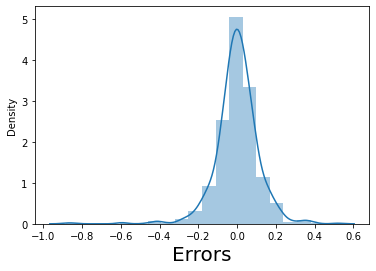

In [285]:
# Plot the distribution plot of the error terms
fig = plt.figure()
sns.distplot((y_train - y_train_pred), bins = 20)
plt.xlabel('Errors', fontsize = 20)  
plt.show()

In [286]:
### taking the independent columns out of the final train data
cols=X_train_mlr.columns

In [287]:
## Removing the constant column
X_test_temp=X_test_new[cols[1:]]

In [288]:
## Adding constant to the test data
X_test_final=sm.add_constant(X_test_temp)

In [289]:
##Predicting on test set
y_test_pred=lr_model.predict(X_test_final)

In [290]:
## finding the claues of erros
error=y_test - y_test_pred

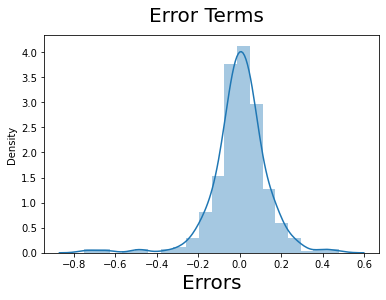

In [291]:
# Plot the histogram of the error terms
fig = plt.figure()
sns.distplot(error, bins = 20)
fig.suptitle('Error Terms', fontsize = 20)
plt.xlabel('Errors', fontsize = 20)  
plt.show()

#### Error terms are normally distributed

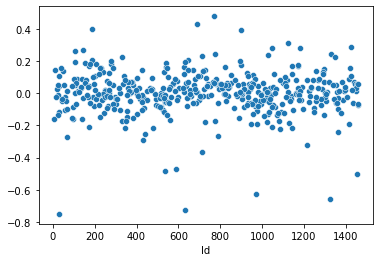

In [292]:
## plotting scatter plot of error terms
sns.scatterplot(data=error)
plt.show()

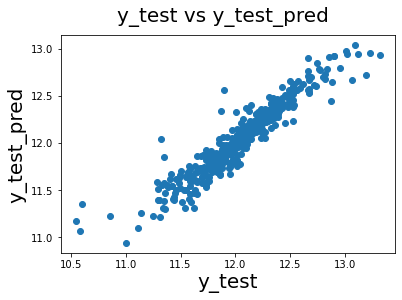

In [293]:
## plotting y_test vs y_test_pred
fig = plt.figure()
plt.scatter(y_test, y_test_pred)
fig.suptitle('y_test vs y_test_pred', fontsize = 20)
plt.xlabel('y_test', fontsize = 20)
plt.ylabel('y_test_pred', fontsize = 20)
plt.show()

In [294]:
## calculating the r2 score
r2_score(y_test, y_test_pred)

0.8896592369326483

## Ridge Regression

In [295]:
## list of alphas

params = {'alpha': [0.0001, 0.001, 0.01, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 
                    9.0, 10.0, 20, 50, 100, 500, 1000 ]}

##creating an object of ridge
ridge = Ridge()

## cross validation

folds = 5
ridge_model = GridSearchCV(estimator = ridge, 
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            
ridge_model.fit(X_train_new, y_train) 

Fitting 5 folds for each of 27 candidates, totalling 135 fits


GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.0001, 0.001, 0.01, 0.1, 0.2, 0.3, 0.4, 0.5,
                                   0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 4.0, 5.0,
                                   6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500,
                                   1000]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [296]:
## Printing the values of optimal lambda for ridge regression
print(ridge_model.best_params_)
print(ridge_model.best_score_)

{'alpha': 6.0}
-0.08157218986285915


In [297]:
# display the mean scores

ridge_results = pd.DataFrame(ridge_model.cv_results_)
ridge_results = ridge_results[ridge_results['param_alpha']<=500]
ridge_results[['param_alpha', 'mean_train_score', 'mean_test_score', 'rank_test_score']].sort_values(by = ['rank_test_score'])

,param_alpha,mean_train_score,mean_test_score,rank_test_score
17,6.0,-0.076059,-0.081572,1
18,7.0,-0.076202,-0.081579,2
16,5.0,-0.075925,-0.081589,3
19,8.0,-0.076345,-0.081598,4
20,9.0,-0.076486,-0.081625,5
21,10.0,-0.076630,-0.081650,6
15,4.0,-0.075831,-0.081681,7
14,3.0,-0.075774,-0.081852,8
13,2.0,-0.075746,-0.082102,9
22,20,-0.077951,-0.082127,10


In [298]:
# check the coefficient values with lambda = 6

alpha = 6
ridge = Ridge(alpha=alpha)

ridge.fit(X_train_new, y_train)
ridge.coef_


array([ 0.03567039,  0.08849179,  0.04815163,  0.        ,  0.03612959,
        0.04810775,  0.03913868,  0.03335611,  0.01279885, -0.07245818,
        0.13480345, -0.02790542,  0.05408328,  0.0774876 ,  0.02836157,
        0.02738987, -0.02612272, -0.03692756,  0.07097829, -0.09354278,
       -0.02805508, -0.0804289 , -0.05683808, -0.04684896, -0.06226586,
        0.04954643, -0.04372784, -0.06045866, -0.04058514,  0.06156356,
       -0.0160095 ,  0.01946866,  0.07042757, -0.03445823, -0.06257458,
       -0.08532713, -0.0176925 , -0.02162541,  0.08206493,  0.03110402,
        0.02674797,  0.05250941,  0.06421787,  0.10361188,  0.04304301,
        0.02982888, -0.03276146,  0.03776019,  0.0563154 ,  0.03776019])

In [299]:
# Check the mean squared error test data
mean_squared_error(y_test, ridge.predict(X_test_new))

0.017774607660541286

In [300]:
# Check the mean squared error on train data
mean_squared_error(y_train, ridge.predict(X_train_new))

0.012826851492631425

In [301]:
## R2 Score for train using ridge
r2_score(y_train, ridge.predict(X_train_new))

0.9183996984131728

In [302]:
## R2 Score for test using ridge
r2_score(y_test, ridge.predict(X_test_new))

0.8919740180351977

In [303]:
## creating a dataframe with attributes and coeff
ridge_dataframe = pd.DataFrame({'Attributes':X_train_new.columns, 'Coeff':ridge.coef_.round(4)})
ridge_dataframe.reset_index(drop=True, inplace=True)
ridge_dataframe.sort_values(by='Coeff', ascending=False)

,Attributes,Coeff
10,Total_Area,0.1348
43,Functional_Typ,0.1036
1,OverallQual,0.0885
38,Exterior1st_BrkFace,0.0821
13,MSZoning_RL,0.0775
18,Neighborhood_Crawfor,0.0710
32,Condition1_Norm,0.0704
42,Functional_Min2,0.0642
29,Neighborhood_Somerst,0.0616
48,SaleCondition_Normal,0.0563


### Lasso Regression

In [304]:
lasso = Lasso()

# list of alphas

params = {'alpha': [0.0001, 0.0002, 0.0003, 0.0004, 0.0005, 0.001, 0.002, 0.003, 0.004, 0.005, 0.01]}

# cross validation

folds = 5
lasso_model = GridSearchCV(estimator = lasso,                         
                        param_grid = params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = folds, 
                        return_train_score=True,
                        verbose = 1)            

lasso_model.fit(X_train_new, y_train) 

Fitting 5 folds for each of 11 candidates, totalling 55 fits


GridSearchCV(cv=5, estimator=Lasso(),
             param_grid={'alpha': [0.0001, 0.0002, 0.0003, 0.0004, 0.0005,
                                   0.001, 0.002, 0.003, 0.004, 0.005, 0.01]},
             return_train_score=True, scoring='neg_mean_absolute_error',
             verbose=1)

In [305]:
## Printing the values of optimal lambda for lasso regression
print(lasso_model.best_params_)
print(lasso_model.best_score_)

{'alpha': 0.0002}
-0.08288099490912282


In [306]:
#display the mean scores

lasso_results = pd.DataFrame(lasso_model.cv_results_)
lasso_results[['param_alpha', 'mean_train_score', 'mean_test_score', 'rank_test_score']].sort_values(by = ['rank_test_score'])

,param_alpha,mean_train_score,mean_test_score,rank_test_score
1,0.0002,-0.075856,-0.082881,1
0,0.0001,-0.075829,-0.082895,2
2,0.0003,-0.076047,-0.082960,3
3,0.0004,-0.076348,-0.083022,4
4,0.0005,-0.076701,-0.083128,5
5,0.001,-0.078678,-0.083870,6
6,0.002,-0.082565,-0.086546,7
7,0.003,-0.086319,-0.089291,8
8,0.004,-0.088322,-0.090277,9
9,0.005,-0.089227,-0.090691,10


In [307]:
# check the coefficient values with lambda = 0.0002

alpha = 0.0002

lasso = Lasso(alpha=alpha)
        
lasso.fit(X_train_new, y_train) 
lasso.coef_

array([ 0.03546877,  0.08597785,  0.04726152,  0.        ,  0.03805231,
        0.04556924,  0.03822393,  0.03260893,  0.01520588, -0.07210437,
        0.13813002, -0.02790848,  0.07237309,  0.09666849,  0.05098402,
        0.02729167, -0.02414945, -0.04168189,  0.07312131, -0.10159123,
       -0.03135575, -0.09596224, -0.06609647, -0.05308911, -0.06978566,
        0.05115947, -0.05153484, -0.0693478 , -0.04375731,  0.06424911,
       -0.0145421 ,  0.01868817,  0.07227921, -0.03278708, -0.06608078,
       -0.09882748, -0.00905039, -0.01232634,  0.09416311,  0.03097339,
        0.02680603,  0.09173496,  0.1051321 ,  0.13846502,  0.05572449,
        0.02728785, -0.03131237,  0.03970807,  0.05626138,  0.03383126])

In [308]:
# Check the mean squared error on train data
mean_squared_error(y_train, lasso.predict(X_train_new))

0.012662682977271739

In [309]:
# Check the mean squared error on test data
mean_squared_error(y_test, lasso.predict(X_test_new))

0.01782426240193331

In [310]:
## R2 Score for train using lasso
r2_score(y_train, lasso.predict(X_train_new))

0.9194440856793782

In [311]:
## R2 Score for test using lasso
r2_score(y_test, lasso.predict(X_test_new))

0.8916722390986089

In [312]:
# Put the shortlisted Features and coefficienst in a dataframe

lasso_dataframe = pd.DataFrame({'Attributes':X_train_new.columns, 'Coeff':lasso.coef_.round(4)})
lasso_dataframe = lasso_dataframe[lasso_dataframe['Coeff'] != 0.00]
lasso_dataframe.reset_index(drop=True, inplace=True)
lasso_dataframe.sort_values(by='Coeff', ascending=False)

,Attributes,Coeff
42,Functional_Typ,0.1385
9,Total_Area,0.1381
41,Functional_Min2,0.1051
12,MSZoning_RL,0.0967
37,Exterior1st_BrkFace,0.0942
40,Functional_Min1,0.0917
1,OverallQual,0.0860
17,Neighborhood_Crawfor,0.0731
11,MSZoning_FV,0.0724
31,Condition1_Norm,0.0723


## Optimal value of lambda for Ridge is 6 and Lasso is 0.0002
### We also see that Ridge/Lasso performs better than simple linear regression
#### R2_Score_Linear :- 0.8891
#### R2_Score_Ridge :- 0.8919
#### R2_Score_Lasso :- 0.8916
###### since the value of R2 is slightly better for ridge regression we will be using Ridge for our final model

### the top 15 features that are playing an important role in dtermining the price is as follows

- Total_Area
- Functional_Typ
- OverallQual
- Exterior1st_BrkFace
- MSZoning_RL
- Neighborhood_Crawfor
- Condition1_Norm
- Functional_Min2
- Neighborhood_Somerst
- SaleCondition_Normal
- MSZoning_FV
- Functional_Min1
- Neighborhood_NridgHt
- OverallCond
- 1stFlrSF